# Machine Learning - Recommender System

---

#### **Load  Data & libraries**

In [ ]:
import dtale
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import iplot, init_notebook_mode

from pyproj import CRS, Transformer
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler

In [14]:
data = pd.read_csv('../Divar Dataset/Divar.csv')
data.drop('Unnamed: 0', axis=1, inplace=True)

/var/folders/9y/lpsdwq1d0bz2t5178sr1rgmr0000gn/T/ipykernel_4290/1300283319.py:1: DtypeWarning:

Columns (11,27,29,53) have mixed types. Specify dtype option on import or set low_memory=False.



In [5]:
# # d-tale
# d = dtale.show(data)
# d.open_browser()

## **Part 1** <br>
↪ Clustering Data Using K-Means Algorithm with 10 Clusters

### **Preprocessing & Finding Best Feature Set**

First we will try `K-means` on  4 different feature sets namely: `feature_set_[1,2,3,4]` to find a better clustering feature set.<br>
To achieve the best set, we then evaluate our clustering model with the following `Evaluation Metrics`:<br>

* `davies_bouldin_score`
* `Inertia` (SSE - Sum of Squared Errors)

Finally, we choose the `best feature set` to plot on Iran's map and show the clustering data comprehensively

In [ ]:
# Intuitive feature selection for K-means
feature_set_1 = data[['city_slug', 'price_value', 'building_size', 'cat3_slug']]
feature_set_2 = data[['location_latitude', 'location_longitude', 'price_value']]
feature_set_3 = data[['location_latitude', 'location_longitude', 'price_value', 'building_size', 'construction_year']]
feature_set_4 = data[['location_latitude', 'location_longitude', 'price_value', 'rent_value', 'credit_value']]

Preprocess Feature Set 1:

In [ ]:
# Handling missing values
feature_set_1 = feature_set_1.dropna()

# Encoding Nominal features
# Frequency Encoding for city_slug
freq_encoding = feature_set_1['city_slug'].value_counts().to_dict()
feature_set_1['city_slug'] = feature_set_1['city_slug'].map(freq_encoding)

# Binary Encoding for cat3_slug
be = BinaryEncoder()
temp = be.fit_transform(feature_set_1[['cat3_slug']])
feature_set_1 = pd.concat([feature_set_1, temp], axis=1)
feature_set_1.drop(columns=['cat3_slug'], inplace=True)

# Outlier Handling
pf = PowerTransformer(method='yeo-johnson')
feature_set_1['price_value'] = pf.fit_transform(feature_set_1[['price_value']])

# Feature Scaling
scaler = StandardScaler()
feature_set_1_scaled = scaler.fit_transform(feature_set_1)
feature_set_1_scaled = pd.DataFrame(feature_set_1_scaled, columns=feature_set_1.columns)

Preprocess Feature Set 2:

In [ ]:
# Handling missing values
feature_set_2 = feature_set_2.dropna()

# Outlier Handling
pf = PowerTransformer(method='yeo-johnson')
feature_set_2['price_value'] = pf.fit_transform(feature_set_2[['price_value']])

# Feature Scaling
scaler = StandardScaler()
feature_set_2_scaled = scaler.fit_transform(feature_set_2)
feature_set_2_scaled = pd.DataFrame(feature_set_2_scaled, columns=feature_set_2.columns)

Preprocess Feature Set 3:

In [ ]:
# Handling missing values
feature_set_3 = feature_set_3.dropna()

# Digits conversion to english
def persian_to_english(sample_input: str):
    persian_digits = '۰۱۲۳۴۵۶۷۸۹'
    english_digits = '0123456789'
    trans_table = str.maketrans(persian_digits, english_digits)
    return sample_input.translate(trans_table)

feature_set_3['construction_year'] = feature_set_3.loc[:, 'construction_year'].apply(
    lambda x: persian_to_english(x) if isinstance(x, str) else x)

# change to only digits
feature_set_3['construction_year'] = feature_set_3['construction_year'].replace('قبل از 1370', '1370')
# change to numeric type
feature_set_3['construction_year'] = pd.to_numeric(feature_set_3['construction_year'], errors='coerce')
feature_set_3['age'] = 1404 - feature_set_3['construction_year']
feature_set_3.drop(columns=['construction_year'], inplace=True)

# Outlier Handling
pf = PowerTransformer(method='yeo-johnson')
feature_set_3['price_value'] = pf.fit_transform(feature_set_3[['price_value']])
feature_set_3['building_size'] = pf.fit_transform(feature_set_3[['building_size']])

# Feature Scaling
scaler = StandardScaler()
feature_set_3_scaled = scaler.fit_transform(feature_set_3)
feature_set_3_scaled = pd.DataFrame(feature_set_3_scaled, columns=feature_set_3.columns)

Preprocess Feature Set 4:

In [ ]:
# Fill price_value missing values with transformed_price based on rent_value and credit_value
def rent_to_price(rent, credit):
    """
    Convert rent to price
    """
    if rent < 0 or credit < 0:
        return 0
    credit_total = credit + (rent * 100) / 3
    transformed_price = credit_total * 6
    return max(0, transformed_price)

# Transform price value
feature_set_4.loc[:, 'price_value'] = feature_set_4.apply(
    lambda row: rent_to_price(row['rent_value'], row['credit_value']) if
      (pd.isna(row['price_value']) & pd.notna(row['rent_value']) & pd.notna(row['credit_value'])) else row['price_value'],
       axis=1)

# Drop unnessary features
feature_set_4 = feature_set_4.drop(columns=['rent_value', 'credit_value'], axis=1)

# Handling missing values
feature_set_4 = feature_set_4.dropna()

# Outlier Handling
feature_set_4_cp = feature_set_4.copy()
pf = PowerTransformer(method='yeo-johnson')
feature_set_4_cp['price_value'] = pf.fit_transform(feature_set_4_cp[['price_value']])

# Feature Scaling
scaler = StandardScaler()
feature_set_4_scaled = scaler.fit_transform(feature_set_4_cp)
feature_set_4_scaled = pd.DataFrame(feature_set_4_scaled, columns=feature_set_4_cp.columns)

#### Evaluation 
We use `k-means` with `n_cluster=10` for the feature sets. <br>
Then we evaluate the trained models with <b>2 different metrics</b>.

In [ ]:
k_values = 10
features_dict = {'Feature Set 1': feature_set_1_scaled,
                 'Feature Set 2': feature_set_2_scaled,
                 'Feature Set 3': feature_set_3_scaled,
                 'feature_set_4': feature_set_4_scaled
                 }
results_dict = {}
for feature_name, feature_data in features_dict.items():
    kmeans = KMeans(n_clusters=k_values, random_state=42)
    cluster_labels = kmeans.fit_predict(feature_data)
    davies_bouldin = davies_bouldin_score(feature_data, cluster_labels)
    results_dict[feature_name] = {
        'davies_bouldin': davies_bouldin,
        'Inertia': kmeans.inertia_
    }
    
print(pd.DataFrame(results_dict).T)

               davies_bouldin        Inertia
Feature Set 1        0.808282  637690.187921
Feature Set 2        0.901254  224791.580539
Feature Set 3        1.156761  585068.830427
feature_set_4        0.784098  378977.759181



According to the results, `Davis Bouldin` is the lowest for this feature set. So we now, make it as out <b>best choice</b><br>
Now we want to do `k-means` with `k=10` and with `feature_set_4`.

#### Best Feature set: `feature_set_4`:<br>
**↪ Features to select:** `location_latitude`, `location_longitude`, `price_value`, `rent_value`, `credit_value`

In [ ]:
# Delete unnessary variables
del feature_set_1, feature_set_1_scaled, feature_set_2, feature_set_2_scaled
del feature_set_3, feature_set_3_scaled, temp, freq_encoding, cluster_labels
del feature_data, feature_name, features_dict, feature_set_4_cp, feature_set_4_scaled, kmeans

#### Work on Chosen Feature Set

Remove data points out of **Iran's borders** using **GeoPandas**:

In [27]:
# Get only datapoints within Iran's borders
import geopandas as gpd

# Build GeoDataFrame in WGS84
gdf = gpd.GeoDataFrame(
    feature_set_4,
    geometry=gpd.points_from_xy(
        feature_set_4["location_longitude"],
        feature_set_4["location_latitude"]
    ),
    crs="EPSG:4326"
)

# Load Iran border (Natural Earth)
iran = gpd.read_file(
    "https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip"
)
iran = iran[iran["NAME"] == "Iran"].to_crs("EPSG:4326")

# Spatial filter
iran_geom = iran.geometry.iloc[0]
gdf = gdf[gdf.within(iran_geom)].copy()


Convert geographical coordinates to UTM format:

In [29]:
# Find and add Iran's UTM zones
gdf['utm_zone'] = (np.floor((gdf['location_longitude'] + 180) / 6) + 1).astype(int)
print("Zones are: ", gdf['utm_zone'].unique())

Zones are:  [39 40 38 41]


In [30]:
# Adding UTM cordinations to the data points
def apply_utm_conversion(group):
    zone = group.name
    wgs84_crs = CRS.from_epsg(4326)
    utm_crs = CRS.from_epsg(32600 + zone)
    transformer = Transformer.from_crs(wgs84_crs, utm_crs, always_xy=True)
    
    easting, northing = transformer.transform(
        group['location_longitude'].values,
        group['location_latitude'].values
    )
    
    group['utm_easting'] = easting
    group['utm_northing'] = northing
    return group

gdf = gdf.groupby(['utm_zone'], group_keys=False).apply(apply_utm_conversion, include_groups=False)
gdf.head()

,location_latitude,location_longitude,price_value,geometry,utm_easting,utm_northing
2,35.703865,51.373459,9.700000e+09,POINT (51.37346 35.70387),533784.424602,3.951168e+06
7,35.729832,51.505466,8.700000e+09,POINT (51.50547 35.72983),545711.558185,3.954101e+06
8,35.712364,50.794781,6.500000e+08,POINT (50.79478 35.71236),481437.130969,3.952066e+06
10,35.778664,51.757549,2.600000e+09,POINT (51.75755 35.77866),568467.028494,3.959664e+06
11,35.733952,51.380608,7.200000e+09,POINT (51.38061 35.73395),534418.187237,3.954507e+06


#### **Outlier Handling**

See variables distributions:

array([[<Axes: title={'center': 'location_latitude'}>,
        <Axes: title={'center': 'location_longitude'}>],
       [<Axes: title={'center': 'price_value'}>,
        <Axes: title={'center': 'utm_easting'}>],
       [<Axes: title={'center': 'utm_northing'}>, <Axes: >]], dtype=object)

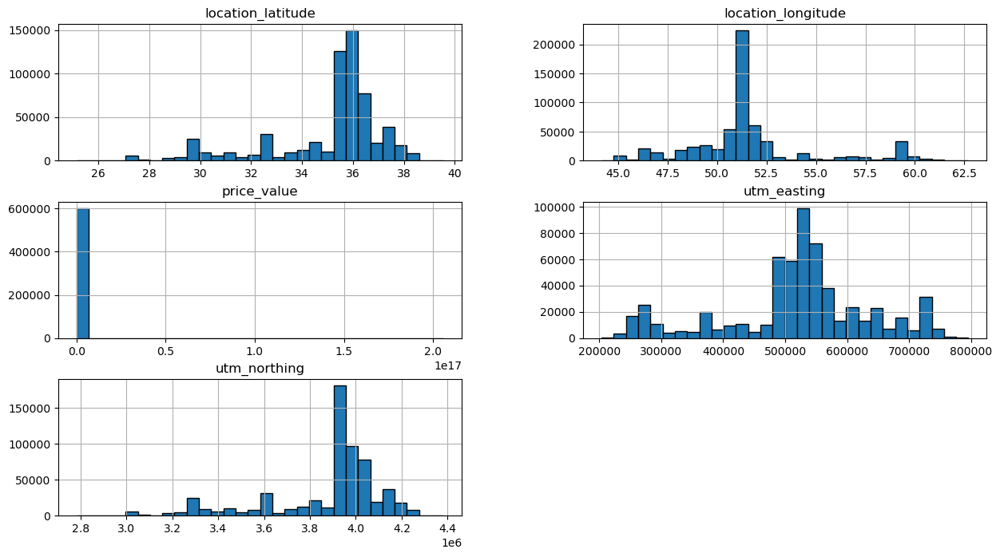

In [31]:
gdf.hist(figsize=(15, 8), bins=30, edgecolor='black')

Apply Power Transformers:

In [32]:
# Import yea_johnson power transformer
from sklearn.preprocessing import PowerTransformer

# Initialize the transformer
pt = PowerTransformer(method='yeo-johnson')
# Apply the transformation  
gdf['price_value'] = pt.fit_transform(gdf[['price_value']])

#### **Feature Scaling**

Feature Scaling to have better clustering using K-means.

In [ ]:
# Feature Scaling on the Features : utm_easting , utm_northing, price_value
scaler_5 = StandardScaler()
gdf_scaled = scaler_5.fit_transform(gdf[['location_latitude', 'location_longitude', 'price_value']])
gdf_scaled = pd.DataFrame(gdf_scaled, columns=['location_latitude', 'location_longitude', 'price_value'])

### **Train K-Means Model for Clustering**<br>

In [ ]:
from sklearn.cluster import KMeans

# Train the model
kmeans = KMeans(n_clusters=10, random_state=42)
cluster_labels = kmeans.fit_predict(gdf_scaled)
gdf['cluster_number'] = cluster_labels

# Find the original cluster centers
centers_scaled = kmeans.cluster_centers_
centers_original = scaler_5.inverse_transform(centers_scaled)

# location_latitude, location_longitude of centroids
centers_lat = centers_original[:, 0]  
centers_lon = centers_original[:, 1] 

# inverse transform price_value
gdf['price_value'] = pf.inverse_transform(gdf[['price_value']])

#### **Plot The Map**

In [42]:
# Plot the Map

# Force cluster_number to be categorical by converting it to string
gdf["cluster_number"] = gdf["cluster_number"].astype(str)

# Define a cluster color palette
cluster_colors = {
    0: "#264653",  # deep blue-gray
    1: "#2A9D8F",  # dark teal
    2: "#1B4332",  # dark green
    3: "#9B2226",  # dark red
    4: "#5A189A",  # deep purple
    5: "#7F5539",  # dark brown
    6: "#C9184A",  # dark magenta
    7: "#495057",  # charcoal gray
    8: "#B08900",  # dark mustard
    9: "#005F73",  # dark cyan
}

fig = px.scatter_map(
    gdf, 
    lat='location_latitude', 
    lon='location_longitude', 
    color='cluster_number',
    color_discrete_map=cluster_colors,
    hover_data=['price_value', 'utm_easting', 'utm_northing'],
    map_style="open-street-map",
    zoom=3, 
    center={"lat": 32.4279, "lon": 53.6880},
    title='Geographical Scatter Plot of samples with K-means Clusters (10 Clusters)',
    width=1550,
    height=800,
)

# Add Cluster Centers
fig.add_trace(
    go.Scattermap(
        lat=centers_lat,
        lon=centers_lon,
        mode='markers+text',
        marker=dict(size=15, color='red', symbol='star', ),
        text=[f'Cluster {i}' for i in range(len(centers_lat))],
        textposition="top center",
        textfont=dict(size=12),
        hovertemplate='<b>Cluster %{text}</b><br>Lat: %{lat}<br>Lon: %{lon}<extra></extra>'
    )
)

fig.show()

#### **↪ Analysis**:
According to the map, it is obviou that thera are meaningfull clusters that each one cover a region: <br>
- One cluster (Cluster 0) covers most properties from **Northern-Center** (*Tehran*, *Alborz*, *Ghom*, *Semnan*, *Ghazvin*) and **North** of Iran (*Mazandaran*, *Gilan*, *Golestan*).

- One Cluster (Cluster 4) covers most properties from **Northern-West** (*East** &* *West* *Azarbaijan*, *Kurdestan*, *Ardebil*, *Zanjan*) of Iran.

- One cluster (Cluster 9) covers most properties from **West** (Lorestan, Markazi, Hamedan, Kermanshah, Ilam) of Iran.

- One cluster (Cluster 1) covers most properties from **Northern-East** (*Khorasan*, a part of *Golestan*) from Iran.

- One cluster (Cluster 5) covers most properties from **South** and **South-East** of Iran (*Hormozgan*, *Kerman*, *Sistan* & *Baluchestan*, parts of *Fars*).

- One Cluster (Cluster 2) covers most properties from **South West** (*Khozestan*, *Bushehr*, *Isfahan*, *Chaharmahal*, *Kohgiluye*) of Iran.
<br>

⚠️ When you look closly, you'll see some regions contain multiple clusters. One conclusion from this can be the diversity of prices between different neighborhood or **Class Difference** in the region.<br><br>
↪ As an example, in **Tehran** there are some properties located in the northern area of the city that belongs to another cluster (cluster 3).<br>
↪ Also in **North** of Iran, properties near the **Caspian see** are from a different cluster.

---

## **Part 2** <br>
Find the best **K** for clustering by leveraging multiple methods.

#### **#1 Method:**  Elbow method (with WSS, also called inertia)

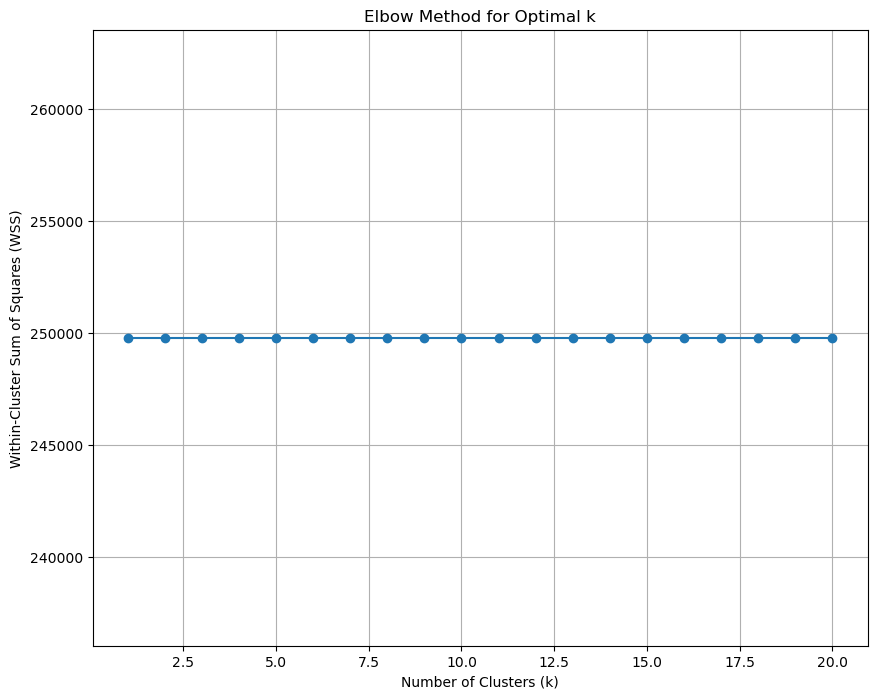

In [39]:
# Defne range of k values
k_range = range(1, 21)

# Compute inertia (WSS) for each k
wss = []
for k in k_range:
    kmeans = KMeans(n_clusters=10, random_state=42, n_init=10)
    # part_1_data['cluster_number'] = kmeans.fit_predict(clustering_features)
    kmeans.fit(part_1_data_scaled)
    wss.append(kmeans.inertia_)

# Plot the Elbow curve
plt.figure(figsize=(10, 8))
plt.plot(k_range, wss, marker='o')  # Plot k vs. WSS with markers
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Within-Cluster Sum of Squares (WSS)')
plt.grid(True)
plt.show()

➡️

#### **#2 Method:** Silhouette Score

In [41]:
from sklearn.metrics import silhouette_score

# Define range of k values (start from 2)
k_range = range(2, 21)

# Compute average silhouette score for each k
sil_scores = []  # List to store scores
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(part_1_data_scaled)
    labels = kmeans.labels_  # Get cluster labels for each point
    score = silhouette_score(part_1_data_scaled, labels)  # Compute average silhouette
    sil_scores.append(score)

# Plot the Silhouette curve
plt.figure(figsize=(8, 5))
plt.plot(k_range, sil_scores, marker='o')
plt.title('Silhouette Score for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Average Silhouette Score')
plt.grid(True)
plt.show()

KeyboardInterrupt: 

➡️

#### **#3 Method:** Calinski-Harabasz Index

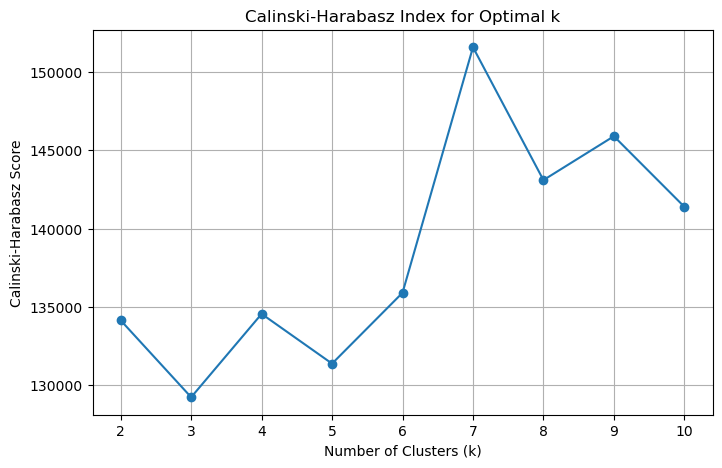

In [42]:
from sklearn.metrics import calinski_harabasz_score

# Define range of k values (start from 2)
k_range = range(2, 11)

# Compute Calinski-Harabasz scores
ch_scores = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(part_1_data_scaled)
    labels = kmeans.labels_
    score = calinski_harabasz_score(part_1_data_scaled, labels)  # Compute CH score
    ch_scores.append(score)

# Plot the scores
plt.figure(figsize=(8, 5))
plt.plot(k_range, ch_scores, marker='o')
plt.title('Calinski-Harabasz Index for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Calinski-Harabasz Score')
plt.grid(True)
plt.show()

➡️

#### **#4 Method:** Davies-Bouldin Index

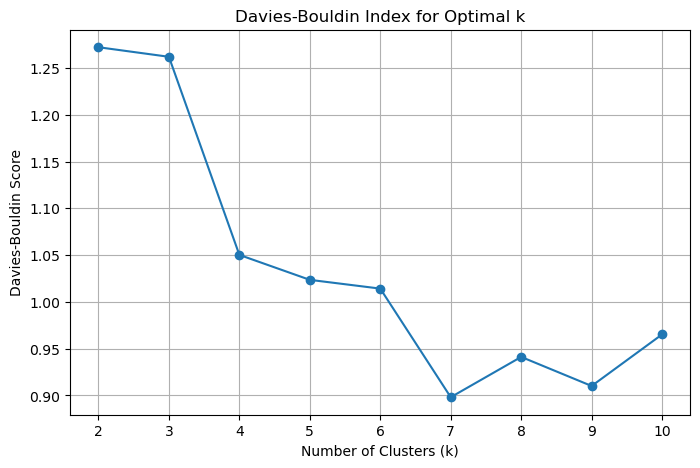

In [44]:
from sklearn.metrics import davies_bouldin_score

# Define range of k values (start from 2)
k_range = range(2, 11)

# Compute Davies-Bouldin scores
db_scores = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(part_1_data_scaled)
    labels = kmeans.labels_
    score = davies_bouldin_score(part_1_data_scaled, labels)  # Compute DB score
    db_scores.append(score)

# Plot the scores
plt.figure(figsize=(8, 5))
plt.plot(k_range, db_scores, marker='o')
plt.title('Davies-Bouldin Index for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Davies-Bouldin Score')
plt.grid(True)
plt.show()

➡️

In [46]:
# plot the clusters again¸

In [ ]:
del part_1_data, part_1_data_scaled, gdf, db_scores, ch_scores, sil_scores, fig

---

## **Part 3** <br>
Clustering Using DBSCAN Algorithm.

### **Preprocessing**

**Features to select:** `location_latitude`, `location_longitude`, `price_value`, `rent_value`, and `credit_value`

In [3]:
part_3_data = data[['location_latitude', 'location_longitude', 'price_value', 'rent_value', 'credit_value']]

Calculate a comparable price for each property:

In [4]:
def rent_to_price(rent, credit):
    """
    Convert rent to price
    """
    if rent < 0 or credit < 0:
        return 0
    credit_total = credit + (rent * 100) / 3
    transformed_price = credit_total * 6
    return max(0, transformed_price)

In [5]:
part_3_data['price_value'] = part_3_data.apply(
    lambda row: rent_to_price(row['rent_value'], row['credit_value']) if
    (pd.isna(row['price_value']) & pd.notna(row['rent_value']) & pd.notna(row['credit_value'])) else row['price_value'], axis=1)

/var/folders/9y/lpsdwq1d0bz2t5178sr1rgmr0000gn/T/ipykernel_4988/4028670527.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Drop Unnessessary columns:

In [6]:
part_3_data = part_3_data.drop(columns=['rent_value', 'credit_value'], axis=1)

#### **Handling Missings:**
Drop values that have missings

In [7]:
part_3_data = part_3_data.dropna()
part_3_data.shape

(606910, 3)

Show statistic summary:

In [8]:
part_3_data.describe()

,location_latitude,location_longitude,price_value
count,606910.000000,606910.000000,6.069100e+05
mean,34.998485,51.634878,2.397772e+12
std,2.337019,3.144181,3.363517e+14
min,23.636976,40.162369,0.000000e+00
25%,34.619293,50.747288,1.560000e+09
50%,35.722771,51.351130,3.000000e+09
75%,36.288515,51.783497,5.950000e+09
max,40.358055,74.511620,2.060000e+17


Convert geographical coordinates to UTM format:

In [9]:
# Create and find UTM zones
part_3_data['utm_zone'] = (np.floor((part_3_data['location_longitude'] + 180) / 6) + 1).astype(int)

print("Zones are: ", part_3_data['utm_zone'].unique())

Zones are:  [39 40 38 41 43 37]


In [10]:
def apply_utm_conversion(group):
    """
    Apply UTM conversion.
    """
    # Extract the UTM zone number
    zone = group.name
    # Define coordinate reference systems
    wgs84_crs = CRS.from_epsg(4326)
    utm_crs = CRS.from_epsg(32600 + zone)

    # Create a coordinate transformer
    transformer = Transformer.from_crs(wgs84_crs, utm_crs, always_xy=True)
    
    # Convert all points in the group
    easting, northing = transformer.transform(
        group['location_longitude'].values,
        group['location_latitude'].values
    )
    
    # Convert all points in the group
    group['utm_easting'] = easting
    group['utm_northing'] = northing
    return group

In [11]:
# Apply UTM conversion
part_3_data = part_3_data.groupby(['utm_zone'], group_keys=False).apply(apply_utm_conversion, include_groups=False)
part_3_data['utm_zone'] = (np.floor((part_3_data['location_longitude'] + 180) / 6) + 1).astype(int)
part_3_data.head()

,location_latitude,location_longitude,price_value,utm_easting,utm_northing,utm_zone
2,35.703865,51.373459,9.700000e+09,533784.424602,3.951168e+06,39
7,35.729832,51.505466,8.700000e+09,545711.558185,3.954101e+06,39
8,35.712364,50.794781,6.500000e+08,481437.130969,3.952066e+06,39
10,35.778664,51.757549,2.600000e+09,568467.028494,3.959664e+06,39
11,35.733952,51.380608,7.200000e+09,534418.187237,3.954507e+06,39


#### Take Smaller Sample From Data

In [12]:
sample_size = 100000
sampled_data = part_3_data.sample(sample_size, random_state=42)
sampled_data.shape

(100000, 6)

#### **Outlier Handling**

See variables distributions:

array([[<Axes: title={'center': 'location_latitude'}>,
        <Axes: title={'center': 'location_longitude'}>],
       [<Axes: title={'center': 'price_value'}>,
        <Axes: title={'center': 'utm_easting'}>],
       [<Axes: title={'center': 'utm_northing'}>,
        <Axes: title={'center': 'utm_zone'}>]], dtype=object)

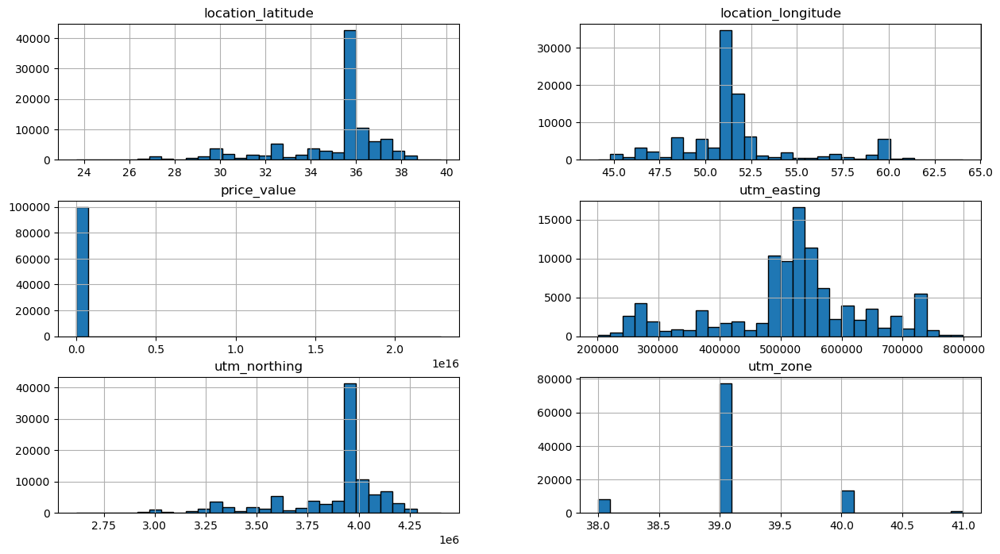

In [13]:
sampled_data.hist(figsize=(15, 8), bins=30, edgecolor='black')

Apply Power Transformers:

In [14]:
# Import yea_johnson power transformer
from sklearn.preprocessing import PowerTransformer

# Initialize the transformer
pt = PowerTransformer(method='yeo-johnson')
cols_to_transform = ['price_value']
pt.fit(sampled_data[cols_to_transform])
# Apply the transformation  
sampled_data[cols_to_transform] = pt.transform(sampled_data[cols_to_transform])

#### **Feature Scaling**

Feature Scaling to have better clustering using K-means.

In [49]:
# Feature Scaling on the Features : utm_easting , utm_northing, price_value
scaler = StandardScaler()

sampled_data_scaled = scaler.fit_transform(sampled_data[['utm_easting', 'utm_northing', 'price_value']])
sampled_data_scaled = pd.DataFrame(sampled_data_scaled, columns=['utm_easting', 'utm_northing', 'price_value'])
sampled_data_scaled.head()

,utm_easting,utm_northing,price_value
0,0.387673,-0.984668,0.448264
1,-1.063959,0.978876,-0.202049
2,1.386031,0.677577,1.084887
3,1.127762,-2.308062,-0.041966
4,0.218927,0.309028,0.554247


#### **Tune DBSCAN Hyperparameters (esp & min_samples)**

#### Find Best **esp**:

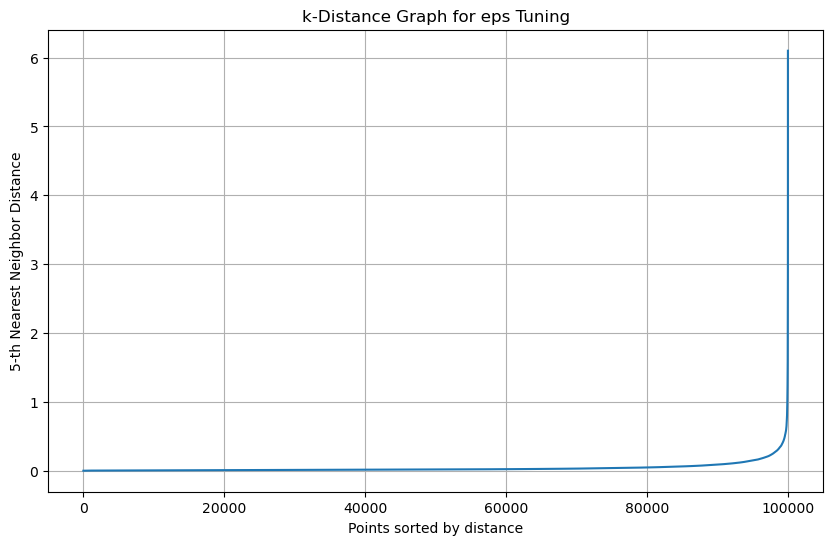

In [50]:
from sklearn.neighbors import NearestNeighbors

# Compute distances to the k-th nearest neighbor (k = min_samples candidate, e.g., 4-10)
k = 5
nn = NearestNeighbors(n_neighbors=k)
nn.fit(sampled_data_scaled)
neigh_distances, neigh_indices = nn.kneighbors()

best_dist = neigh_distances[:, -1]
sorted_dist = np.sort(best_dist)

# Plot
plt.figure(figsize=(10, 6))
plt.plot(range(len(best_dist)), sorted_dist)
plt.xlabel('Points sorted by distance')
plt.ylabel(f'{k}-th Nearest Neighbor Distance')
plt.title('k-Distance Graph for eps Tuning')
plt.grid(True)
plt.show()

In [18]:
from kneed import KneeLocator
loc = KneeLocator(range(len(sorted_dist)), sorted_dist, curve='convex')
loc.elbow, loc.knee

(np.int64(99942), np.int64(99942))

In [119]:
print(f"↪ Best eps value: {sorted_dist[loc.elbow]}")

↪ Best eps value: 2.684696524621959


#### Find Best **min_samples**:

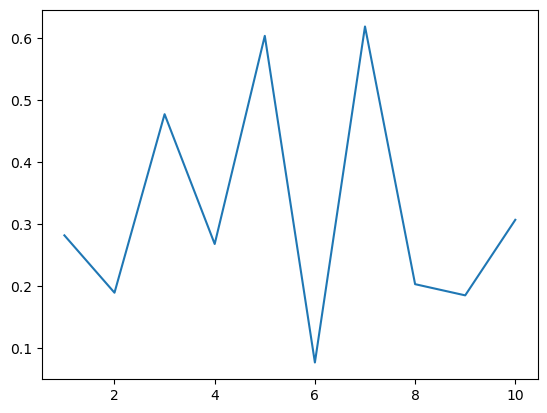

In [120]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

sample_list = []
distance_list = []
for min_sample in range(1, 11):
    nn = NearestNeighbors(n_neighbors=min_sample)
    nn.fit(sampled_data)
    neigh_dist, _ = nn.kneighbors()
    best_dist = neigh_dist[:, -1]
    sorted_dist = np.sort(best_dist)
    loc = KneeLocator(range(len(sorted_dist)), sorted_dist, curve='convex')
    db = DBSCAN(eps=sorted_dist[loc.elbow],min_samples=min_sample, n_jobs=-1)
    lables = db.fit_predict(sampled_data)
    sample_list.append(silhouette_score(sampled_data, lables))
    distance_list.append(sorted_dist[loc.elbow])
plt.plot(range(1, 11), sample_list)
plt.show()

↪ According to the plot, silhouette score is better when **k** equals to 7

#### **Train DBSCAN on Tuned Hyperparameters**<br>

0.5, 2000
1, 5000

In [305]:
from sklearn.cluster import DBSCAN

# Create a DBSCAN model
dbscan = DBSCAN(eps=0.5, min_samples=3000, n_jobs=-1)

sampled_data['cluster_number'] = dbscan.fit_predict(sampled_data_scaled)

In [306]:
sampled_data['cluster_number'].value_counts()

cluster_number
 0    65072
-1    31409
 1     3519
Name: count, dtype: int64

In [307]:
centroids_utm = (
    sampled_data
    .groupby("cluster_number")[["utm_easting", "utm_northing"]]
    .mean()
    .reset_index()
)

centroids_utm["utm_zone"] = (
    sampled_data
    .groupby("cluster_number")["utm_zone"]
    .agg(lambda x: x.mode().iloc[0])
    .values
)

In [308]:
from pyproj import Transformer

latitudes = []
longitudes = []

for _, row in centroids_utm.iterrows():
    zone = int(row["utm_zone"])
    
    transformer = Transformer.from_crs(
        f"EPSG:326{zone}",  # UTM zone
        "EPSG:4326",        # WGS84
        always_xy=True
    )
    
    lon, lat = transformer.transform(
        row["utm_easting"],
        row["utm_northing"]
    )
    
    latitudes.append(lat)
    longitudes.append(lon)

centroids_utm["latitude"] = latitudes
centroids_utm["longitude"] = longitudes

In [309]:
import geopandas as gpd

# Build GeoDataFrame in WGS84
gdf = gpd.GeoDataFrame(
    sampled_data,
    geometry=gpd.points_from_xy(
        sampled_data["location_longitude"],
        sampled_data["location_latitude"]
    ),
    crs="EPSG:4326"
)

# Load Iran border (Natural Earth)
iran = gpd.read_file(
    "https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip"
)
iran = iran[iran["NAME"] == "Iran"].to_crs("EPSG:4326")

# Spatial filter
iran_geom = iran.geometry.iloc[0]
gdf = gdf[gdf.within(iran_geom)].copy()

In [310]:
import plotly.express as px

# Force cluster_number to be categorical by converting it to string
# gdf["cluster_number"] = gdf["cluster_number"].astype(str)

# palette = sns.color_palette("Set2", 10).as_hex()

# cluster_colors = {
#     0: "#264653",  # deep blue-gray
#     1: "#2A9D8F",  # dark teal
#     2: "#1B4332",  # dark green
#     3: "#9B2226",  # dark red
#     4: "#5A189A",  # deep purple
#     5: "#7F5539",  # dark brown
#     6: "#C9184A",  # dark magenta
#     7: "#495057",  # charcoal gray
#     8: "#B08900",  # dark mustard
#     9: "#005F73",  # dark cyan
# }

fig = px.scatter_map(
    gdf,
    lat="location_latitude",
    lon="location_longitude",
    color="cluster_number",
    # color_discrete_sequence=palette,
    hover_data={
        "price_value": True,
        "utm_easting": ":.0f",
        "utm_northing": ":.0f",
        "location_latitude": False,
        "location_longitude": False,
    },
    map_style="open-street-map",
    zoom=3,
    center={"lat": 32.4279, "lon": 53.6880},
    title="K-Means Clusters (k=10) — Filtered to Iran<br><sup>Clustering done in UTM space</sup>",
    width=1550,
    height=800,
)

fig.add_trace(
    go.Scattermap(
        lat=centroids_utm["latitude"],
        lon=centroids_utm["longitude"],
        mode="markers+text",
        marker=dict(
            size=40,
            color="#000000",
            symbol="x"
        ),
    
        text=[f"C{i}" for i in centroids_utm["cluster_number"]],
        textposition="top center",
        hoverinfo="text",
        hovertext=[
            f"Cluster {row.cluster_number}<br>"
            f"UTM Easting: {row.utm_easting:,.0f}<br>"
            f"UTM Northing: {row.utm_northing:,.0f}"
            for _, row in centroids_utm.iterrows()
        ]
    )
)

fig.update_traces(
   marker=dict(size=7) 
)

fig.show()